<a href="https://colab.research.google.com/github/ludmilaexbrayat/recognizing-packagings/blob/master/Full_Data_Model.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Full Data Model

## Install Drive

In [0]:
from google.colab import drive
drive.mount('/content/drive')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3Aietf%3Awg%3Aoauth%3A2.0%3Aoob&scope=email%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdocs.test%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdrive%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdrive.photos.readonly%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fpeopleapi.readonly&response_type=code

Enter your authorization code:
··········
Mounted at /content/drive


## Directory Setup

In [0]:
# Cloning Git repo in Google Collab
!git clone https://github.com/ludmilaexbrayat/recognizing-packagings.git
%cd recognizing-packagings/


Cloning into 'recognizing-packagings'...
remote: Enumerating objects: 29, done.
remote: Counting objects: 100% (29/29), done.
remote: Compressing objects: 100% (22/22), done.
remote: Total 182 (delta 13), reused 19 (delta 7), pack-reused 153
Receiving objects: 100% (182/182), 51.69 MiB | 25.40 MiB/s, done.
Resolving deltas: 100% (85/85), done.
/content/recognizing-packagings


## Library


In [0]:
# General Packages

import pandas as pd
import numpy as np
import time
import pickle
import os
import sys
import json
import matplotlib.pyplot as plt
%matplotlib inline


# Torch Specific

import torch
from torch.utils.data.dataset import Dataset
from torch.utils.data import DataLoader
import torch.optim as optim
from torch.autograd import Variable
import torch.nn.functional as F

import torch.nn as nn

import torchvision
from torchvision import models,transforms,datasets

from PIL import Image


# Project Specific

sys.path.append(str(os.getcwd() + '/scripts'))
from Preprocessing import MultiLabelDataset

## Import Data

In [0]:
## create a folder img and put images inside 
%mkdir data_img

### unrar files from drive in data_img

In [0]:
%%time

!unrar x /content/drive/'My Drive'/X_img_part1.rar data_img


UNRAR 5.50 freeware      Copyright (c) 1993-2017 Alexander Roshal


Extracting from /content/drive/My Drive/X_img_part1.rar

Extracting  data_img/2407.jpg                                              0%  OK 
Extracting  data_img/3053.jpg                                              0%  OK 
Extracting  data_img/6789.jpg                                              0%  OK 
Extracting  data_img/00011693.jpg                                          0%  OK 
Extracting  data_img/00011839.jpg                                          0%  OK 
Extracting  data_img/00018999.jpg                                          0%  OK 
Extracting  data_img/00023092.jpg                                          0%  OK 
Extracting  data_img/00025942.jpg                                          0%  OK 
Extracting  data_img/00028653.jpg                                          0%  OK 
Extracting  data_img/00031059.jpg             

In [0]:
%%time

!unrar x /content/drive/'My Drive'/X_img_part2.rar data_img


UNRAR 5.50 freeware      Copyright (c) 1993-2017 Alexander Roshal


Extracting from /content/drive/My Drive/X_img_part2.rar

Extracting  data_img/18.jpg                                                0%  OK 
Extracting  data_img/000051.jpg                                            0%  OK 
Extracting  data_img/55.jpg                                                0%  OK 
Extracting  data_img/000227.jpg                                            0%  OK 
Extracting  data_img/959.jpg                                               0%  OK 
Extracting  data_img/1802.jpg                                              0%  OK 
Extracting  data_img/3118.jpg                                              0%  OK 
Extracting  data_img/6057.jpg                                              0%  OK 
Extracting  data_img/00008648.jpg                                          0%  OK 
Extracting  data_img/00011686.jpg             

In [0]:
%%time

!unrar x /content/drive/'My Drive'/X_img_part3.rar data_img


UNRAR 5.50 freeware      Copyright (c) 1993-2017 Alexander Roshal


Extracting from /content/drive/My Drive/X_img_part3.rar

Extracting  data_img/0004.jpg                                              0%  OK 
Extracting  data_img/50.jpg                                                0%  OK 
Extracting  data_img/073.jpg                                               0%  OK 
Extracting  data_img/85.jpg                                                0%  OK 
Extracting  data_img/133.jpg                                               0%  OK 
Extracting  data_img/000225.jpg                                            0%  OK 
Extracting  data_img/1230.jpg                                              0%  OK 
Extracting  data_img/00001373.jpg                                          0%  OK 
Extracting  data_img/1664.jpg                                              0%  OK 
Extracting  data_img/00003100.jpg             

In [0]:
%%time

!unrar x /content/drive/'My Drive'/X_img_part4.rar data_img


UNRAR 5.50 freeware      Copyright (c) 1993-2017 Alexander Roshal


Extracting from /content/drive/My Drive/X_img_part4.rar

Extracting  data_img/2.jpg                                                 0%  OK 
Extracting  data_img/000010.jpg                                            0%  OK 
Extracting  data_img/013.jpg                                               0%  OK 
Extracting  data_img/000031.jpg                                            0%  OK 
Extracting  data_img/000050.jpg                                            0%  OK 
Extracting  data_img/00063.jpg                                             0%  OK 
Extracting  data_img/91.jpg                                                0%  OK 
Extracting  data_img/01276.jpg                                             0%  OK 
Extracting  data_img/1473.jpg                                              0%  OK 
Extracting  data_img/2121.jpg                 

In [0]:
%%time

!unrar x /content/drive/'My Drive'/X_img_part5.rar data_img


UNRAR 5.50 freeware      Copyright (c) 1993-2017 Alexander Roshal


Extracting from /content/drive/My Drive/X_img_part5.rar

Extracting  data_img/0006.jpg                                              0%  OK 
Extracting  data_img/000030.jpg                                            0%  OK 
Extracting  data_img/36.jpg                                                0%  OK 
Extracting  data_img/00071.jpg                                             0%  OK 
Extracting  data_img/000104.jpg                                            0%  OK 
Extracting  data_img/212.jpg                                               0%  OK 
Extracting  data_img/0307.jpg                                              0%  OK 
Extracting  data_img/2155.jpg                                              0%  OK 
Extracting  data_img/2192.jpg                                              0%  OK 
Extracting  data_img/2631.jpg                 

In [0]:
%%time

!unrar x /content/drive/'My Drive'/X_img_part6.rar data_img


UNRAR 5.50 freeware      Copyright (c) 1993-2017 Alexander Roshal


Extracting from /content/drive/My Drive/X_img_part6.rar

Extracting  data_img/0009.jpg                                              0%  OK 
Extracting  data_img/11.jpg                                                0%  OK 
Extracting  data_img/24.jpg                                                0%  OK 
Extracting  data_img/100.jpg                                               0%  OK 
Extracting  data_img/000765.jpg                                            0%  OK 
Extracting  data_img/001100.jpg                                            0%  OK 
Extracting  data_img/1202.jpg                                              0%  OK 
Extracting  data_img/00002929.jpg                                          0%  OK 
Extracting  data_img/4046.jpg                                              0%  OK 
Extracting  data_img/0008775.jpg              

In [0]:
%%time

!unrar x /content/drive/'My Drive'/X_img_part7.rar data_img


UNRAR 5.50 freeware      Copyright (c) 1993-2017 Alexander Roshal


Extracting from /content/drive/My Drive/X_img_part7.rar

Extracting  data_img/10.jpg                                                0%  OK 
Extracting  data_img/000721.jpg                                            0%  OK 
Extracting  data_img/1151.jpg                                              0%  OK 
Extracting  data_img/1633.jpg                                              0%  OK 
Extracting  data_img/1702.jpg                                              0%  OK 
Extracting  data_img/2182.jpg                                              0%  OK 
Extracting  data_img/3189.jpg                                              0%  OK 
Extracting  data_img/4465.jpg                                              0%  OK 
Extracting  data_img/00011723.jpg                                          0%  OK 
Extracting  data_img/00013029.jpg             

In [0]:
%%time

!unrar x /content/drive/'My Drive'/X_img_part8.rar data_img


UNRAR 5.50 freeware      Copyright (c) 1993-2017 Alexander Roshal


Extracting from /content/drive/My Drive/X_img_part8.rar

Extracting  data_img/0001.jpg                                              0%  OK 
Extracting  data_img/001.jpg                                               0%  OK 
Extracting  data_img/1.jpg                                                 0%  OK 
Extracting  data_img/00024.jpg                                             0%  OK 
Extracting  data_img/00089.jpg                                             0%  OK 
Extracting  data_img/000127.jpg                                            0%  OK 
Extracting  data_img/476.jpg                                               0%  OK 
Extracting  data_img/000742.jpg                                            0%  OK 
Extracting  data_img/1065.jpg                                              0%  OK 
Extracting  data_img/0000000001281.jpg        

## create train/test separation


In [0]:
import os
import random
import shutil

def img_train_test_split(img_source_dir, train_size):
    """
    Randomly splits images over a train and validation folder, while preserving the folder structure
    
    Parameters
    ----------
    img_source_dir : string
        Path to the folder with the images to be split. Can be absolute or relative path   
        
    train_size : float
        Proportion of the original images that need to be copied in the subdirectory in the train folder
    """    
    if not (isinstance(img_source_dir, str)):
        raise AttributeError('img_source_dir must be a string')
        
    if not os.path.exists(img_source_dir):
        raise OSError('img_source_dir does not exist')
        
    if not (isinstance(train_size, float)):
        raise AttributeError('train_size must be a float')
        
    # Set up empty folder structure if not exists
    if not os.path.exists('/content/data_img'):
      %cd /content/
      %mkdir data_img

    else:
      if not os.path.exists('/content/data_img/train'):
        %cd /content/data_img/
        %mkdir train
      if not os.path.exists('/content/data_img/validation'):
        %cd /content/data_img/
        %mkdir validation
    
    ignored = {"train", "test", "validation"}
    list_files = [x for x in os.listdir(img_source_dir) if x not in ignored]
    indicies_train = random.sample(range(len(list_files)), int(train_size*len(list_files)))
    train_list = [list_files[i] for i in indicies_train]
    test_list = [x for x in list_files if x not in train_list]

    for i in range(0,len(train_list),1):
      shutil.move("/content/data_img/"+str(train_list[i]),
           "/content/data_img/train/"+str(train_list[i]))
    for i in range(0,len(test_list),1):
      shutil.move("/content/data_img/"+str(test_list[i]),
           "/content/data_img/validation/"+str(test_list[i]))

In [0]:
## Check that data_img is in /content/
#%cd ../
#!pwd
#%mv recognizing-packagings/data_img/ ./
#!ls

data_img  drive  recognizing-packagings  sample_data


In [0]:
%%time

img_train_test_split('/content/data_img/',0.9)

/content/data_img
/content/data_img
CPU times: user 7min 15s, sys: 3.88 s, total: 7min 19s
Wall time: 7min 26s


## Load target values


In [0]:
## Check the current working directory
#!pwd
#%cd ../
!pwd

/content


In [0]:
y_target = pd.read_csv('y_target.csv')
y_target.set_index(['code'],inplace=True)
y_target = (y_target>0).replace({True:1, False:0})
y_target.head(2)

,Barquette,Bocal,Boite,Bouteille,Brique,Carton,Conserve,Metal,Papier,Plastique,Pot,Sachet,Verre
code,,,,,,,,,,,,,
0000000001281,1,0,0,0,0,0,0,0,0,1,0,0,0
0000000020114,0,1,0,0,0,0,0,0,0,1,0,0,0


In [0]:
list_files_train = os.listdir('/content/data_img/train/')
list_files_test = os.listdir('/content/data_img/validation/')
#removing .jpeg extension
list_files_train =  [x[:-4] for x in list_files_train]
list_files_test =  [x[:-4] for x in list_files_test]

# create Y_target with only rows in the folder
Y_train = y_target[y_target.index.isin(list_files_train)]
Y_test = y_target[y_target.index.isin(list_files_test)]

In [0]:
print(Y_test.shape)
print(Y_train.shape)

(15199, 13)
(137226, 13)


In [0]:
# transformation of image pipe - at random - don't fortget to transform to tensor 
transformations = transforms.Compose([transforms.Resize((224, 224)),
                                      transforms.ToTensor()])

Dataset construction



In [0]:
# pytorch dataset
train_dset = MultiLabelDataset(df=Y_train,
                          root_dir_img='/content/data_img/train/',
                          transform=transformations)

test_dset = MultiLabelDataset(df=Y_test,
                          root_dir_img='/content/data_img/validation/',
                          transform=transformations)

In [0]:
# verification and training
len(train_dset)

137226

## Constants and Parameters

In [0]:
BATCH_SIZE = 16
IS_SHUFFLE = True
NUM_WORKERS = 0

LEARNING_RATE = 0.001

COLUMNS = np.array(['Barquette',	
                    'Bocal',	
                    'Boite',
                    'Bouteille',
                    'Brique',
                    'Carton',
                    'Conserve',
                    'Metal',
                    'Papier',
                    'Plastique',
                    'Pot',
                    'Sachet',
                    'Verre'])

In [0]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
print('Using gpu: %s ' % torch.cuda.is_available())

Using gpu: True 


###### Data Loader

In [0]:
# Building the data loader from the tupple of tensors
train_loader = DataLoader(train_dset,
                          batch_size=BATCH_SIZE,
                          shuffle=IS_SHUFFLE,
                          num_workers=NUM_WORKERS)

### 2. Building Model

##### Structure for Transfer Learning

In [0]:
# Loading the pretrained VGG model
model_vgg = models.vgg16(pretrained=True)

# Freezing all layers
for param in model_vgg.parameters():
    param.requires_grad = False

# Adding linear layer
model_vgg.classifier._modules['6'] = torch.nn.Linear(4096, 2048)
model_vgg.classifier._modules['7'] = torch.nn.Linear(2048, 13)
model_vgg.classifier._modules['8'] = torch.nn.Sigmoid()
model_vgg.cuda()

# Defining the optimizer
optimizer_vgg = torch.optim.SGD(model_vgg.classifier.parameters(),lr = LEARNING_RATE)

##### Model Training

In [0]:
def train_model(model, dataloader, size, epochs=1, optimizer=None):
    model.train()
    
    for epoch in range(epochs):
        running_loss = 0.0
        for inputs, classes in train_loader:
            
            inputs_try , labels_try = inputs.to(device), classes.to(device)
            outputs_try = model(inputs_try)
            
            loss = torch.nn.BCELoss()
            loss = loss(outputs_try, labels_try)
            
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            
            # statistics
            running_loss += loss.data.item()
        
        epoch_loss = running_loss / size
        print('Loss: {:.4f}'.format(epoch_loss))

In [0]:
# Training the model
train_model(model_vgg, 
    train_loader,
    size=len(train_dset),
    epochs=10,
    optimizer=optimizer_vgg)

Loss: 0.0183
Loss: 0.0164
Loss: 0.0159
Loss: 0.0157
Loss: 0.0155
Loss: 0.0154
Loss: 0.0153
Loss: 0.0152
Loss: 0.0152
Loss: 0.0151


In [0]:
torch.save(model_vgg, 'train_model1.pt')

/usr/local/lib/python3.6/dist-packages/torch/serialization.py:292: UserWarning: Couldn't retrieve source code for container of type VGG. It won't be checked for correctness upon loading.
  "type " + obj.__name__ + ". It won't be checked "
/usr/local/lib/python3.6/dist-packages/torch/serialization.py:292: UserWarning: Couldn't retrieve source code for container of type Sequential. It won't be checked for correctness upon loading.
  "type " + obj.__name__ + ". It won't be checked "
/usr/local/lib/python3.6/dist-packages/torch/serialization.py:292: UserWarning: Couldn't retrieve source code for container of type Conv2d. It won't be checked for correctness upon loading.
  "type " + obj.__name__ + ". It won't be checked "
/usr/local/lib/python3.6/dist-packages/torch/serialization.py:292: UserWarning: Couldn't retrieve source code for container of type ReLU. It won't be checked for correctness upon loading.
  "type " + obj.__name__ + ". It won't be checked "
/usr/local/lib/python3.6/dist-pac

In [0]:
!pwd

/content


### 3. Model Performance Assesment

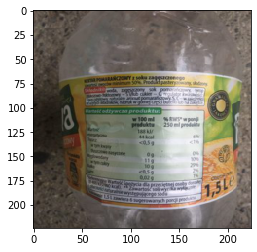


 Raw Predictions:
[0.02482633 0.08097364 0.02194745 0.2078514  0.00635327 0.02944291
 0.0093205  0.0507725  0.01594812 0.55457795 0.07481644 0.11044815
 0.35888627]

 Predicted Labels according to threshold: 
['Plastique']

 Predicted Labels according to the 3 higher probs: 
['Bouteille' 'Verre' 'Plastique']

 True Labels: 
['Bouteille']


In [0]:
# Ploat Prediction vs. true label for a single random image
count = 0
for image, label in train_loader:
  count += 1
  if count == 1:
    image_to_device = image.to(device)
    plt.imshow(np.dstack(image_to_device[0].data.cpu().numpy()))
    plt.show()
    pred = model_vgg(image_to_device)[0].data.cpu().numpy()
    print('\n Raw Predictions:')
    print(pred)
    print('\n Predicted Labels according to threshold: ')
    print(COLUMNS[pred >= 0.5])
    print('\n Predicted Labels according to the 3 higher probs: ')
    print(COLUMNS[np.argsort(pred)[-3:]])
    print('\n True Labels: ')
    print(COLUMNS[label[0] == 1])
    break